In [336]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

from pandas_profiling import ProfileReport

from sklearn.feature_selection import mutual_info_regression, mutual_info_classif
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, RobustScaler
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.ensemble import ExtraTreesRegressor, RandomForestRegressor
#custom modules
from bokeh_reduce_scatter import bokeh_reduce_scatter

from sklearn.metrics import explained_variance_score,max_error, mean_absolute_error,mean_squared_error, r2_score





In [122]:
train_data = pd.read_csv('../Datacase1_PartA_Train.csv', sep = ';')
train_data = train_data.dropna(subset = ['Main_Incoming_Water'])
test_data = train_data.sample(frac = 0.2)
train_indexes = list(set(train_data.index) - set(test_data.index))
train_data = train_data.iloc[train_indexes]

# Profilling

In [88]:
profile = ProfileReport(train_data, title='Pandas Profiling Report', explorative=True)
log_profile = ProfileReport(np.log1p(train_data.loc[:,train_data.dtypes == float]), title='Pandas Profiling Report', explorative=True)

In [89]:
profile

In [90]:
log_profile

# Feature engineering and selection

We are going to to feature selection based on top Mutual Information and Spearman Correlation (rank correlation)
We wont use PCA or another akin for dimensionality reduction because we're intrested
in the features that better explains the targe and not the features that better explains 
variance in feature space

In [124]:
random_vars = ['Packed_Volume',
       'Beer_Brewed_HG', 'Racked_Volume', 'Filter_Total_volume',
       'Line_1_Packed_Volume', 'Line_2_Packed_Volume', 'Line_3_Packed_Volume',
       'Line_4_Packed_Volume', 'Line_5_Packed_Volume', 'Line_6_Packed_Volume']
dependent_var = 'Main_Incoming_Water'

## Feature interaction

In [292]:
combinator = PolynomialFeatures(degree = 2,interaction_only = True)

In [293]:
combinned_features = combinator.fit_transform(train_data[random_vars].fillna(train_data[random_vars].median()))
combinned_features_test = combinator.transform(test_data[random_vars].fillna(train_data[random_vars].median()))

In [294]:
new_random_feature_names = combinator.get_feature_names(random_vars)
new_random_feature_names = [i.replace(' ',' X ') for i in new_random_feature_names]

In [295]:
new_features_df = pd.DataFrame(combinned_features,columns = new_random_feature_names)
new_features_df[dependent_var] = train_data[dependent_var].values
new_features_df['log_target'] = np.log1p(new_features_df[dependent_var])
new_features_df = new_features_df.drop(columns = ['1'])

new_features_df_test = pd.DataFrame(combinned_features_test,columns = new_random_feature_names)
new_features_df_test[dependent_var] = test_data[dependent_var].values
new_features_df_test['log_target'] = np.log1p(new_features_df_test[dependent_var])
new_features_df_test = new_features_df_test.drop(columns = ['1'])

new_random_feature_names = [i for i in new_random_feature_names if i!='1']

## Correlation

In [296]:
corr = new_features_df.corr('spearman')

## Mutual Information

In [297]:
mutual_info = mutual_info_regression(
    new_features_df[new_random_feature_names].values,
    new_features_df[dependent_var].values,
    discrete_features = False
)

# All metrics

In [305]:
df_feature_selection_metrics = pd.DataFrame(columns = new_random_feature_names).T
df_feature_selection_metrics['MI'] = mutual_info
df_feature_selection_metrics['Corr'] = corr.loc[dependent_var, new_random_feature_names].values.flatten()
top_10_MI = list(df_feature_selection_metrics.sort_values(by = 'MI', ascending = False).iloc[:100].index)
df_feature_selection_metrics.sort_values(by = 'MI', ascending = False).iloc[:10]

,MI,Corr
Packed_Volume,1.048527,-0.858590
Packed_Volume X Line_3_Packed_Volume,0.809121,-0.752739
Packed_Volume X Filter_Total_volume,0.752260,-0.721298
Packed_Volume X Line_1_Packed_Volume,0.574588,-0.627597
Packed_Volume X Line_4_Packed_Volume,0.573586,-0.695539
Packed_Volume X Line_5_Packed_Volume,0.573545,-0.680935
Packed_Volume X Racked_Volume,0.507535,-0.587026
Filter_Total_volume X Line_3_Packed_Volume,0.504456,-0.564580
Line_3_Packed_Volume X Line_5_Packed_Volume,0.484774,-0.599684
Line_3_Packed_Volume X Line_4_Packed_Volume,0.475893,-0.613058


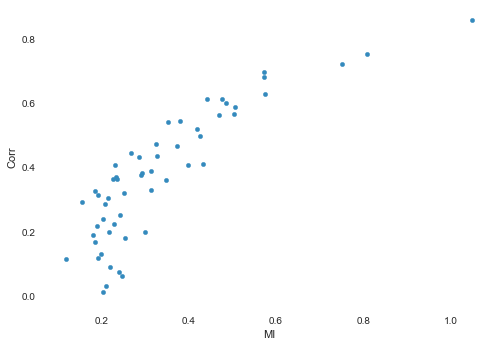

In [306]:
df_feature_selection_metrics.abs().plot.scatter('MI','Corr')

In [307]:
#sns.pairplot(new_features_df[top_10_MI+['log_target']])

# Lin Reg

In [347]:
steps = [
    ('scale',StandardScaler()),
    ('linear_regression',ExtraTreesRegressor())
]

pipe = Pipeline(steps)
pipe.fit(X = new_features_df[top_10_MI].values, y = new_features_df['log_target'].values)

Pipeline(steps=[('scale', StandardScaler()),
                ('linear_regression', ExtraTreesRegressor())])

In [348]:
preds = pipe.predict(new_features_df_test[top_10_MI].values)
new_features_df_test['preds'] = preds

In [349]:
def reg_metrics(y_true,y_pred):
    r2 = r2_score(y_true,y_pred)
    max_ = max_error(y_true,y_pred)
    mae = mean_absolute_error(y_true,y_pred)
    rmse = mean_squared_error(y_true,y_pred)**(1/2)
    metrics_df = pd.DataFrame([r2,max_,mae,rmse]).T
    metrics_df.columns = ['R²','max_error','MAE','RMSE']
    return metrics_df

y_pred = np.expm1(new_features_df_test)['preds']
y_true = np.expm1(new_features_df_test)['log_target']


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: overflow encountered in expm1
  # Remove the CWD from sys.path while we load stuff.
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: overflow encountered in expm1
  # This is added back by InteractiveShellApp.init_path()


In [350]:
reg_metrics(y_true,y_pred)

,R²,max_error,MAE,RMSE
0,0.903376,23.898804,0.582125,2.017754
